In [1]:
import sys
import os

sys.path.append(os.path.dirname('/home/insane/u/APalysis/analysis'))

import keract
import tensorflow as tf
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from nltk.corpus import wordnet as wn
from tensorflow import keras as K
from tqdm import tqdm
from analysis import metrics
import utils
from imagenet_class_to_label import imagenet_class_index_to_name

from sklearn.manifold import MDS
# from sklearn.decomposition import PCA
# from sklearn.preprocessing import StandardScaler
# from sklearn.pipeline import make_pipeline
# from sklearn.metrics import pairwise_distances
# from sklearn.metrics import euclidean_distances
import umap
import warnings
warnings.filterwarnings("ignore", message="using precomputed metric; inverse_transform will be unavailable")

# check if using GPU
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print("Num CPUs Available: ", len(tf.config.experimental.list_physical_devices('CPU')))

2024-03-21 10:11:13.053790: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-21 10:11:13.053818: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-21 10:11:13.054803: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-21 10:11:13.059920: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-03-21 10:11:13.721382: W tensorflow/compiler/tf2

Num GPUs Available:  1
Num CPUs Available:  1


2024-03-21 10:11:18.802219: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-21 10:11:18.817609: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-21 10:11:18.817811: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

100it [00:00, 2655.19it/s]
/home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages/umap/umap_.py:1857: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
100it [00:00, 3782.47it/s]
/home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages/umap/umap_.py:1857: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
100it [00:00, 3214.64it/s]
/home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages/umap/umap_.py:1857: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
100it [00:00, 3819.36it/s]
/home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages

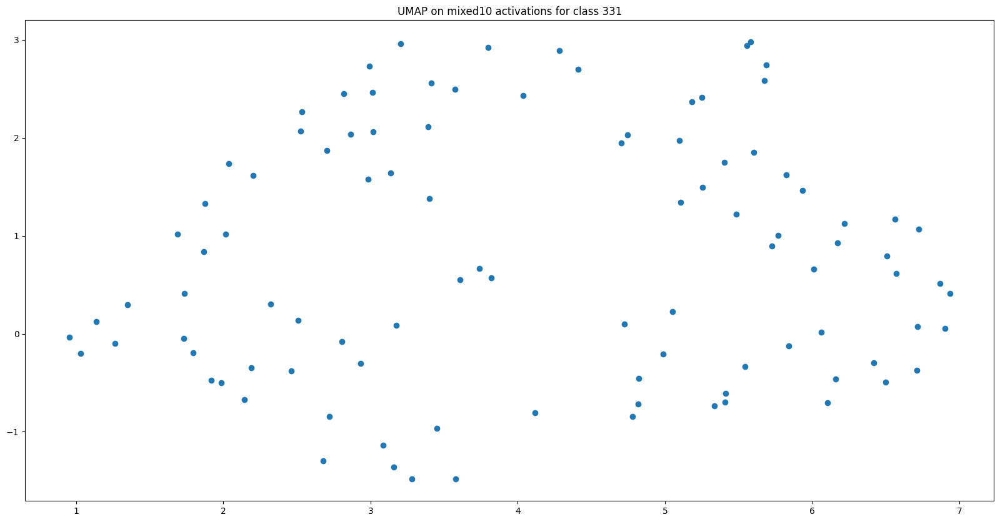

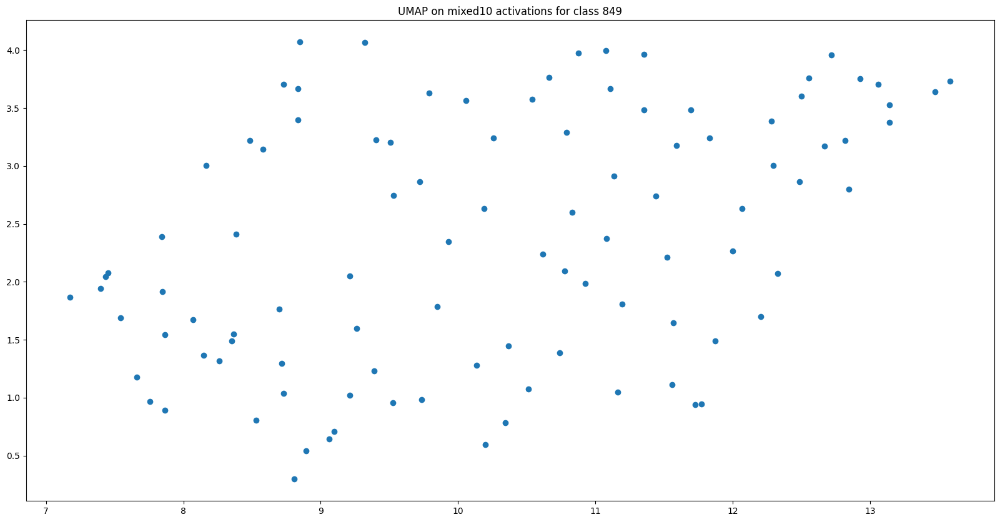

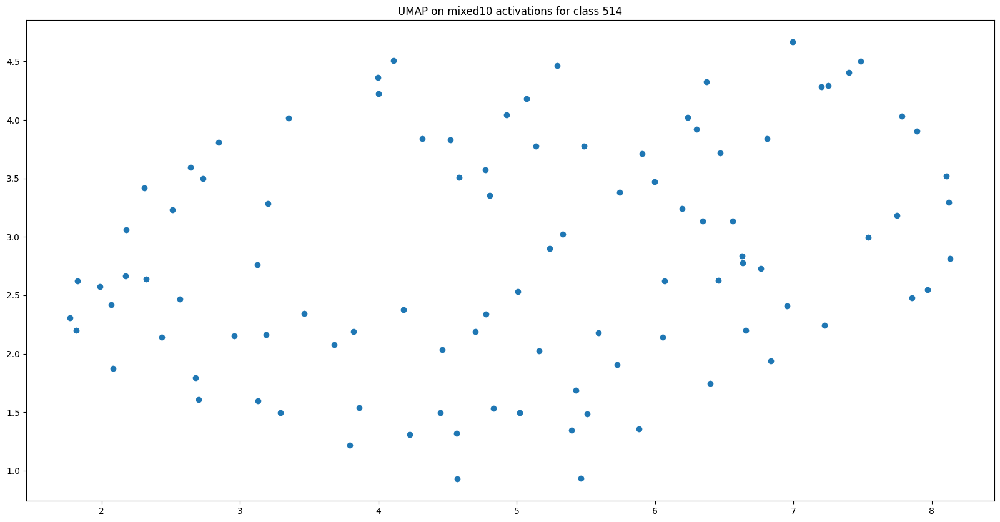

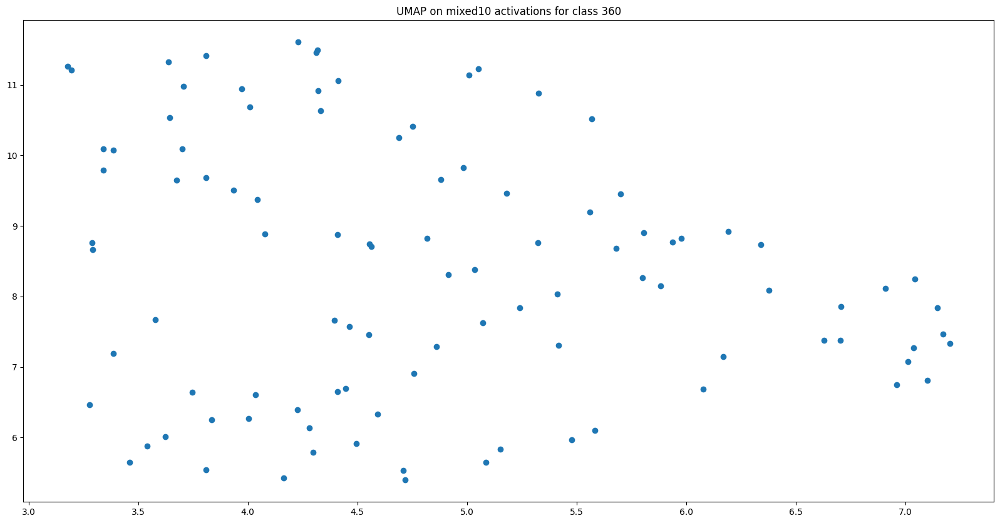

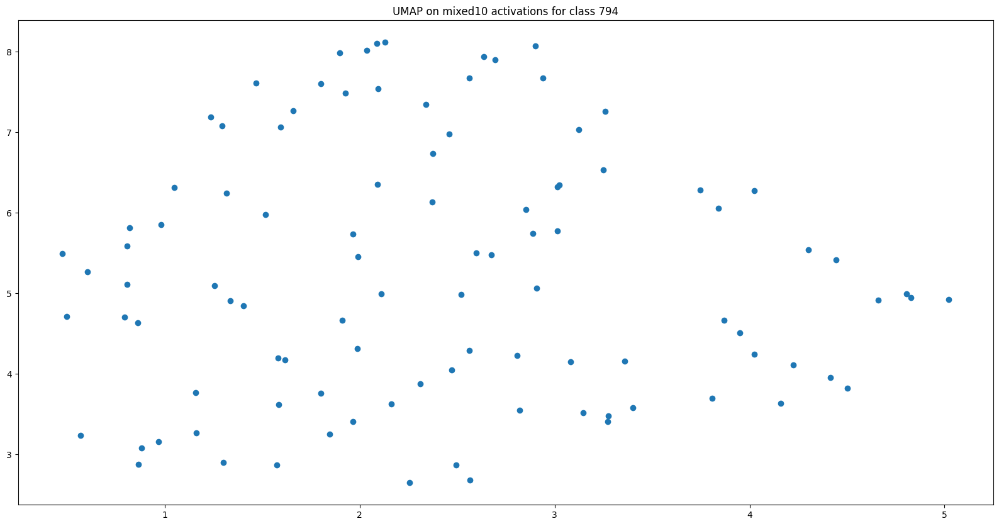

...

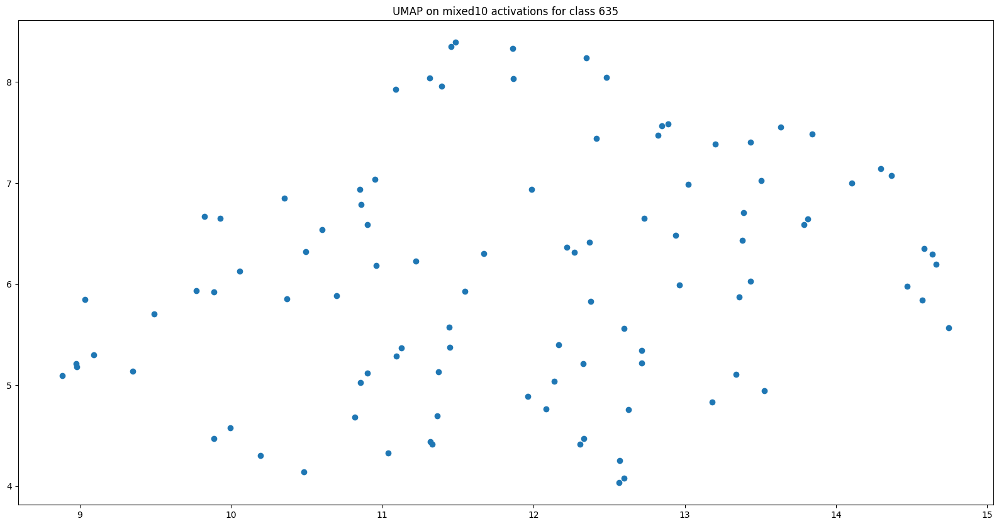

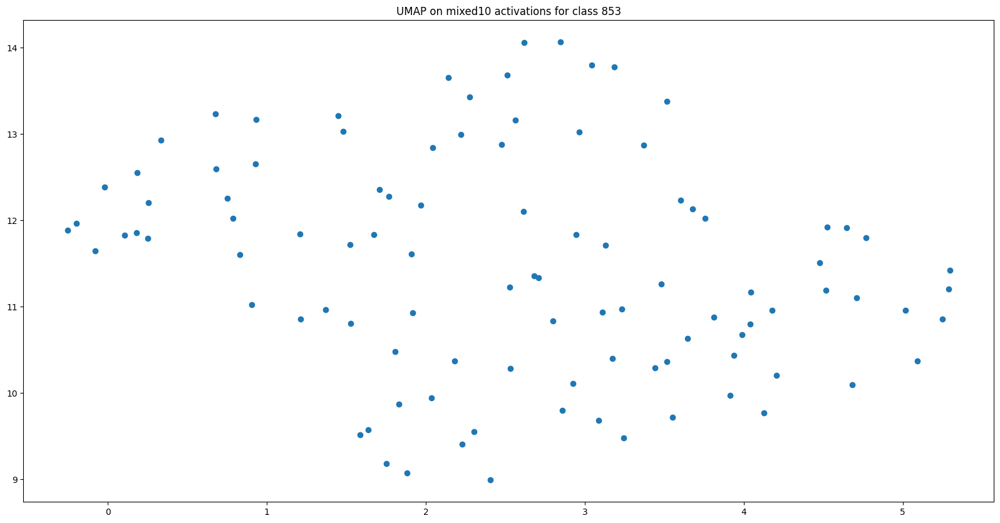

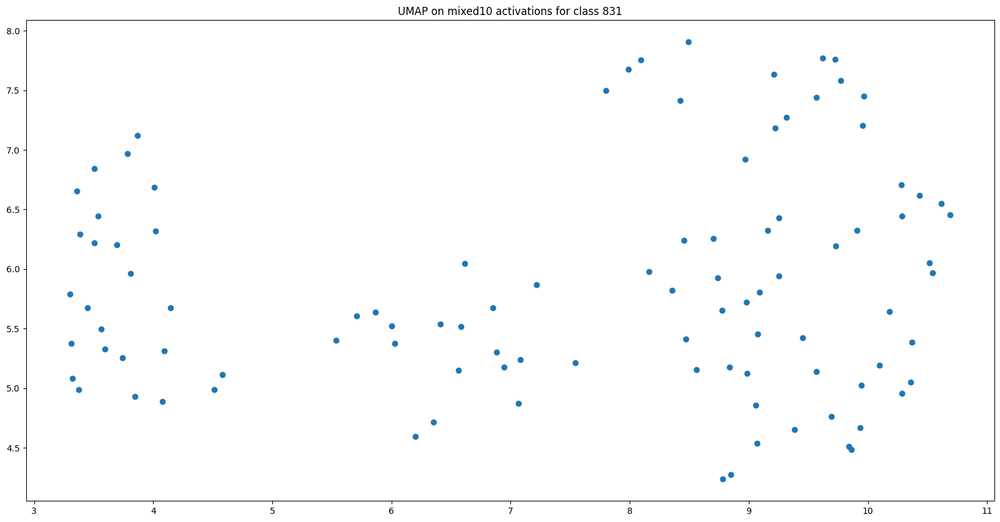

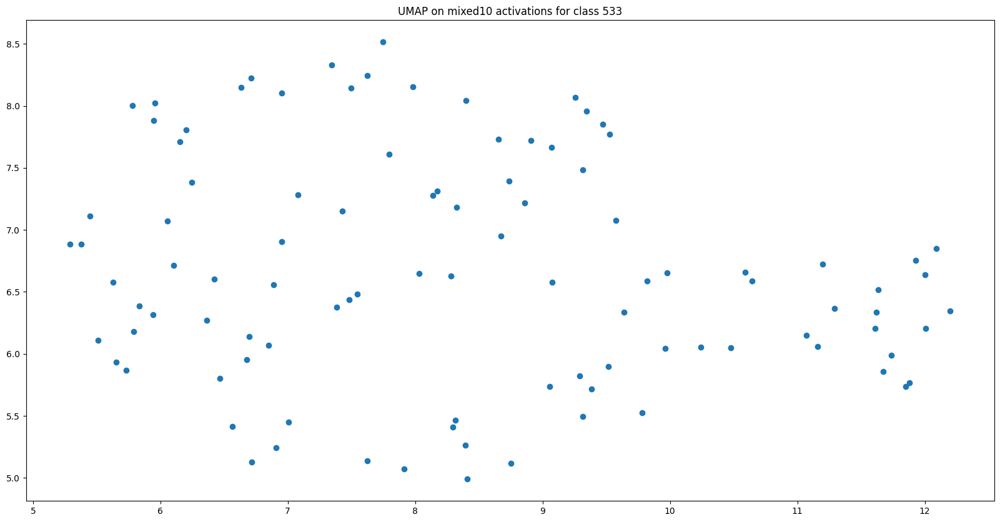

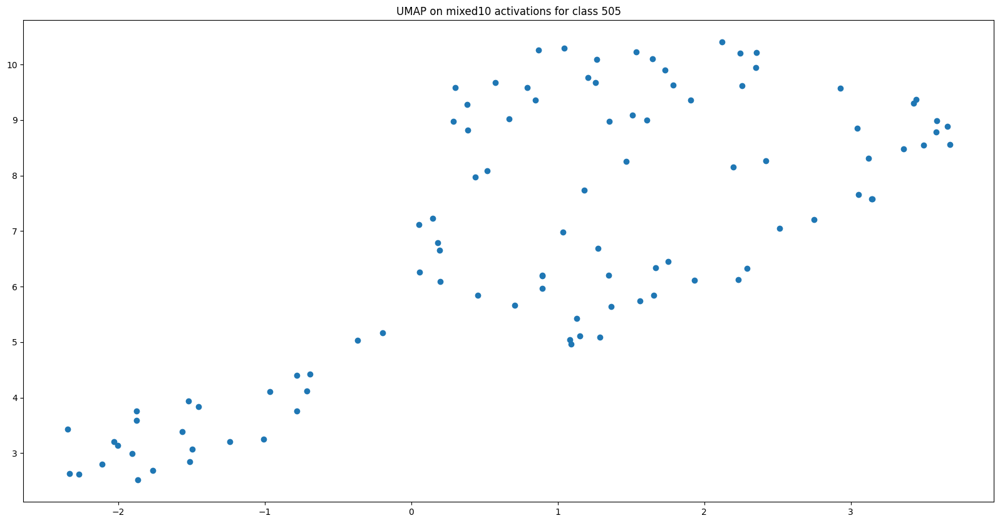

In [5]:
LAYER = "mixed10"
data_path = "/home/insane/u/APalysis/analysis/activation_summary"
N_NEIGHBORS = 10

for file in tqdm(os.listdir(data_path)):
    if not file.endswith(".npz"):
        continue

    class_label = file.split("_")[1].split(".")[0]
    activationsSummary = np.load(f"{data_path}/{file}")[LAYER]

    act_dist_mat = np.zeros((len(activationsSummary), len(activationsSummary)))
    for i, acti in tqdm(enumerate(activationsSummary)):
        for j, actj in enumerate(activationsSummary):
            if i == j:
                act_dist_mat[i, j] = 0
                continue
            if i > j:
                continue
            act_dist_mat[i, j] = utils.single_activation_distance(acti, actj)

            act_dist_mat[j, i] = act_dist_mat[i, j]

    # apply mds to activationsSummary['mixed10]

    mds = MDS(
        n_components=2,
        dissimilarity="precomputed",
        random_state=6,
        normalized_stress="auto",
        verbose=1,
    )
    umap_model = umap.UMAP(
        n_components=2,
        n_neighbors=N_NEIGHBORS,
        metric="precomputed",
    )

    for model in [
        # mds,
        umap_model,
    ]:
        result = model.fit_transform(act_dist_mat)
        fig = plt.figure(figsize=(20, 10))
        sc = plt.scatter(result[:, 0], result[:, 1])
        plt.title(
            f"{model.__class__.__name__} on mixed10 activations for class {class_label}"
        )

        # save the figure without showing
        utils.makedir(f"class_embedding_images/n_neighbors_{N_NEIGHBORS}/{model.__class__.__name__}")
        plt.savefig(
            f"class_embedding_images/n_neighbors_{N_NEIGHBORS}/{model.__class__.__name__}/{LAYER}_{class_label}.png"
        )
        plt.close()

In [2]:
model = tf.keras.applications.inception_v3.InceptionV3( weights='imagenet')
model.compile(loss="categorical_crossentropy", optimizer="adam")

ds, info = tfds.load(
    'imagenet2012',
    shuffle_files=False,
    with_info=True,
    as_supervised=True,
    batch_size=None,
    data_dir='/run/media/insane/Games/Tensorflow/tensorflow_datasets'
)
labels = list(map(lambda l: wn.synset_from_pos_and_offset(
        l[0], int(l[1:])).name(), info.features['label'].names))
ds = ds['train']


inception_input_shape = tf.keras.applications.inception_v3.InceptionV3().input.shape[1:3].as_list()
@tf.function
def preprocess(x, y):
    x = tf.image.resize(x, inception_input_shape, method=tf.image.ResizeMethod.BILINEAR)
    x = tf.keras.applications.inception_v3.preprocess_input(x)
    return x, y

def preprocess_inv(x, y):
    x = ((x / 2 + 0.5) * 255).astype(np.uint8).squeeze()
    return x, y

2024-03-21 10:11:19.026619: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-21 10:11:19.026872: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-03-21 10:11:19.027038: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [3]:
# interesting_classes = [ 208, 498, 345, 534, 538, 282, 231, 288, 246, 380, 815, 381, 593, 253, 271, 384, 298, 319, 332, 403, 429, 442, 460, 461, 471, 494, 529, 647, 659, 671, 715, 731, 760, 762, 827, ]
interesting_classes = list(range(346, 355))
BATCH_SIZE = 1
summary_fn_image = metrics.summary_fn_image_l2
summary_fn_dense = metrics.summary_fn_dense_identity

layers = list(map(lambda layer: layer.name, filter(lambda l: isinstance(l, (
    # K.layers.InputLayer,
    K.layers.Conv2D,
    # K.layers.Dense,
    # K.layers.Flatten,
    K.layers.Concatenate,
)), model.layers)))

labels_so_far = np.zeros(len(labels), dtype=np.int32)
MAX_COUNT = 100
LAYER= 'mixed10'

for class_label in tqdm(interesting_classes):
    __datasetImgs = []
    # __activations = [[] for _ in range(len(labels))]
    __activationsSummary = []
    # __datasetLabels = []
    dataset = ds.map(preprocess).batch(BATCH_SIZE).shuffle(1000)
    # printed = False
    for i, (img, label) in enumerate(dataset):
        if label.numpy().item() != class_label:
            continue
        __datasetImgs.append(img.numpy())

        # Get activations
        activation = keract.get_activations(
            model, img, layer_names=[LAYER], nodes_to_evaluate=None, output_format='simple', nested=False, auto_compile=True)

        activationSummary = {}
        for layer, v in activation.items():
            if layer != LAYER: continue
            if len(v[0].shape) == 1:
                # dense layer
                activationSummary[layer] = summary_fn_dense(v)
            elif len(v[0].shape) == 3:
                # Image layer
                activationSummary[layer] = summary_fn_image(v)
                
        # labels_so_far[label.numpy()] += 1
        # __datasetLabels += label.numpy().tolist()
        
        for layer, summary in activationSummary.items():
            if layer != LAYER: continue
            __activationsSummary += summary.tolist()
            
        if len(__activationsSummary) >= MAX_COUNT:
            break
            
            
    datasetImgs = np.array(__datasetImgs)
    # activations = [j for i in __activations for j in i]
    activationsSummary = np.array(__activationsSummary)
    # datasetLabels = np.array(__datasetLabels)
    
    act_dist_mat = np.zeros((len(activationsSummary), len(activationsSummary)))
    for i, acti in tqdm(enumerate(activationsSummary)):
        for j, actj in enumerate(activationsSummary):
            if i == j:
                act_dist_mat[i, j] = 0
                continue
            if i > j:
                continue
            act_dist_mat[i, j] = utils.single_activation_distance(
                acti, actj
            )
            act_dist_mat[j, i] = act_dist_mat[i, j]
            
    # apply mds to activationsSummary['mixed10]
    umap_model = umap.UMAP(n_components=2, metric='precomputed')
    result = umap_model.fit_transform(act_dist_mat)

    # show scatterplot where each point is is an image from datasetImgs
    fig, ax = plt.subplots()
    ax.set_xlim(result[:, 0].min(), result[:, 0].max())
    ax.set_ylim(result[:, 1].min(), result[:, 1].max())

    for point, img in zip(result, datasetImgs):
        img = ((img / 2 + 0.5) * 255).astype(np.uint8).squeeze()
        img_size = (result[:, 0].max() - result[:, 0].min()) / 10
        img_extent = [point[0] - img_size/2, point[0] + img_size/2, point[1] - img_size/2, point[1] + img_size/2]
        ax.imshow(img, extent=img_extent, aspect='1')

    plt.title(f'{umap_model.__class__.__name__} on mixed10 activations for class {imagenet_class_index_to_name[class_label]}')
    
    # save the figure without showing
    plt.savefig(f"/home/insane/u/interesting_classes/class_{class_label}.png", dpi=500)
    plt.close()
    

  0%|          | 0/9 [00:00<?, ?it/s]2024-03-21 10:11:27.095702: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-03-21 10:11:27.301258: W external/local_xla/xla/service/gpu/llvm_gpu_backend/gpu_backend_lib.cc:504] Can't find libdevice directory ${CUDA_DIR}/nvvm/libdevice. This may result in compilation or runtime failures, if the program we try to run uses routines from libdevice.
Searched for CUDA in the following directories:
  ./cuda_sdk_lib
  /usr/local/cuda-12.2
  /usr/local/cuda
  /home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages/tensorflow/python/platform/../../../nvidia/cuda_nvcc
  /home/insane/.cache/pypoetry/virtualenvs/apalysis-5kmHI_dQ-py3.10/lib/python3.10/site-packages/tensorflow/python/platform/../../../../nvidia/cuda_nvcc
  .
You can choose the search directory by setting xla_gpu_cuda_data_dir in HloModule's DebugOptions.  For most apps, setting the environment variable XLA_FLAGS=